In [3]:
import wfdb
import matplotlib.pyplot as plt
import numpy as np
import os
from scipy.signal import medfilt
import pywt
from ecgdetectors import Detectors
from scipy.signal import resample_poly

nsr_data = ['./data/nsrdb/16265',
 './data/nsrdb/16272',
 './data/nsrdb/16273',
 './data/nsrdb/16420',
 './data/nsrdb/16483',
 './data/nsrdb/16539',
 './data/nsrdb/16773',
 './data/nsrdb/16786',
 './data/nsrdb/16795',
 './data/nsrdb/17052',
 './data/nsrdb/17453',
 './data/nsrdb/18177',
 './data/nsrdb/18184',
 './data/nsrdb/19088',
 './data/nsrdb/19090',
 './data/nsrdb/19093',
 './data/nsrdb/19140',
 './data/nsrdb/19830']

In [5]:
def extract_first_30min_and_segment(record_paths):
    """
    Given a list of NSR record paths (e.g. './data/nsrdb/16265'),
    1) Read the first 30 minutes of the ECG from each record
    2) Segment that 30-min signal into six 5-min parts
    3) Return a dictionary mapping record_name -> [segment1, segment2, ... segment6]
       Each segment is a NumPy array of shape (num_samples_5min, num_channels).
    
    :param record_paths: list of strings, each pointing to a record base path
        (no .hea or .dat extension). e.g.: './data/nsrdb/16265'
    :param out_fs: The known or expected sampling rate for NSR DB (commonly 128 Hz).
    :return: dict: { record_name: [np.array(5-min #1), ..., np.array(5-min #6)] }
    """
    # For 30 min, we have 30 * 60 = 1800 seconds. 
    # For 5 min, we have 5 * 60 = 300 seconds.
    # We'll assume all NSR recordings have at least 30 minutes of data.
    
    first_30min_segments = {}
    
    for record_path in record_paths:
        # Extract record name from path
        # e.g. record_path = "./data/nsrdb/16265" => record_name = "16265"
        record_dir, record_name = os.path.split(record_path)
        
        # if not record_name:
        #     # if the path ends with slash, fix it
        #     record_name = os.path.basename(record_dir)
        #     record_dir = os.path.dirname(record_dir)
        
        # Print progress
        print(f"Processing {record_name} ...")
        
        # 1) Read the entire .hea to confirm sampling frequency (if needed)
        #    If you know for certain it's always 128 Hz, you could skip that step.
        
        # hea_file = os.path.join(record_dir, record_name + ".hea")
        # fs = out_fs  # default
        # if os.path.exists(hea_file):
        #     # Attempt to parse sampling freq from the first line
        #     with open(hea_file, 'r') as f:
        #         header_line = f.readline().strip()  # e.g. "16265 2 128 650000 16:33:00"
        #         # parse the second or third token for sampling freq
        #         parts = header_line.split()
        #         if len(parts) >= 3:
        #             try:
        #                 fs = float(parts[2])
        #             except ValueError:
        #                 pass
        
        # 2) We want the first 30 minutes => 1800 seconds => num_samples = 1800 * fs
        fs = 128
        num_samples_30min = int(30 * 60 * fs)
        
        # Read from sample 0 to sample 0+num_samples_30min
        try:
            rec = wfdb.rdrecord(record_path, sampfrom=0, sampto=num_samples_30min)
        except Exception as e:
            print(f"[ERROR] Could not read {record_path}: {e}")
            continue
        
        if rec.p_signal is None:
            print(f"[WARN] No signal found in {record_name}. Skipping.")
            continue
        
        full_30min = rec.p_signal[:,0]  # shape: (num_samples_30min, n_channels)
        # 3) Segment the 30-min array into six 5-min parts
        # Each 5-min part = 5 * 60 * fs samples
        samples_5min = int(5 * 60 * fs)  # e.g. 300 seconds * 128 => 38400
        
        # Check we do indeed have exactly 6*5 minutes = 30 min
        # If the record is slightly shorter or the reading stops earlier, you might have fewer.
        # We'll assume it's enough. If not, handle partial segments as needed.
        
        # We can slice in 6 equal blocks:
        segments_5min = []
        for i in range(6):
            start_i = i * samples_5min
            end_i = start_i + samples_5min
            segment = full_30min[start_i:end_i]
            segments_5min.append(segment)
        
        # Store in a dictionary
        first_30min_segments[record_name] = segments_5min
        print(f"[OK] Extracted 6 segments of 5 min each from {record_name}.")
    
    return first_30min_segments

In [6]:
nsr_30min_segments = extract_first_30min_and_segment(nsr_data)

Processing 16265 ...
[OK] Extracted 6 segments of 5 min each from 16265.
Processing 16272 ...
[OK] Extracted 6 segments of 5 min each from 16272.
Processing 16273 ...
[OK] Extracted 6 segments of 5 min each from 16273.
Processing 16420 ...
[OK] Extracted 6 segments of 5 min each from 16420.
Processing 16483 ...
[OK] Extracted 6 segments of 5 min each from 16483.
Processing 16539 ...
[OK] Extracted 6 segments of 5 min each from 16539.
Processing 16773 ...
[OK] Extracted 6 segments of 5 min each from 16773.
Processing 16786 ...
[OK] Extracted 6 segments of 5 min each from 16786.
Processing 16795 ...
[OK] Extracted 6 segments of 5 min each from 16795.
Processing 17052 ...
[OK] Extracted 6 segments of 5 min each from 17052.
Processing 17453 ...
[OK] Extracted 6 segments of 5 min each from 17453.
Processing 18177 ...
[OK] Extracted 6 segments of 5 min each from 18177.
Processing 18184 ...
[OK] Extracted 6 segments of 5 min each from 18184.
Processing 19088 ...
[OK] Extracted 6 segments of 5

In [7]:
nsr_30min_segments

{'16265': [array([-0.165, -0.155, -0.195, ..., -0.295, -0.135, -0.295]),
  array([-0.285, -0.285, -0.185, ..., -0.365,  1.475,  2.795]),
  array([ 2.935,  2.535,  0.605, ..., -0.195, -0.145, -0.165]),
  array([-0.145, -0.115, -0.125, ..., -0.145, -0.145, -0.135]),
  array([-0.175, -0.135, -0.175, ..., -0.135, -0.135, -0.105]),
  array([-0.115, -0.125, -0.115, ..., -0.135, -0.175, -0.175])],
 '16272': [array([-0.185, -0.215, -0.215, ...,  0.055, -0.255, -0.205]),
  array([-0.175, -0.205, -0.175, ..., -0.085, -0.075, -0.055]),
  array([-0.085, -0.085, -0.095, ..., -0.095, -0.065, -0.005]),
  array([ 0.575,  1.135,  0.475, ..., -0.075, -0.065, -0.065]),
  array([-0.075, -0.075, -0.085, ...,  1.255, -0.115, -0.685]),
  array([-0.475, -0.155, -0.085, ..., -0.045, -0.045, -0.055])],
 '16273': [array([-0.305, -0.265, -0.245, ..., -0.015, -0.005, -0.005]),
  array([ 0.005,  0.035, -0.005, ...,  1.485,  2.755,  3.225]),
  array([ 1.925,  0.335, -0.205, ..., -0.135, -0.135, -0.135]),
  array([-0

In [11]:
first5minOF16265 = nsr_30min_segments['16265'][0]
second5minOF16265 = nsr_30min_segments['16265'][1]

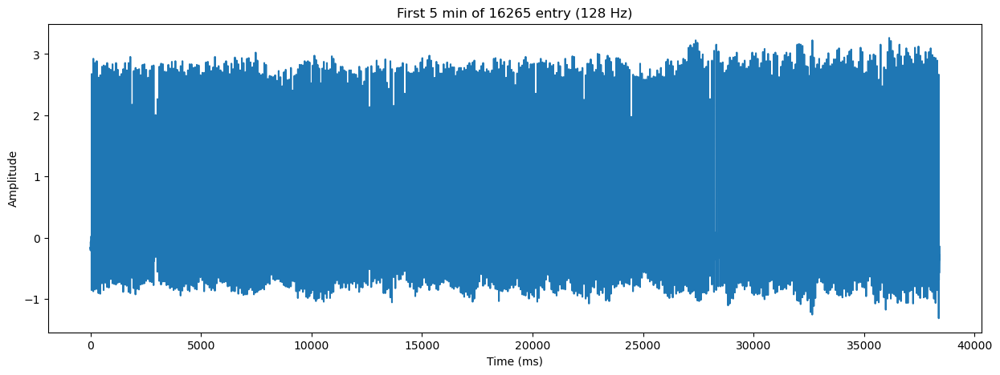

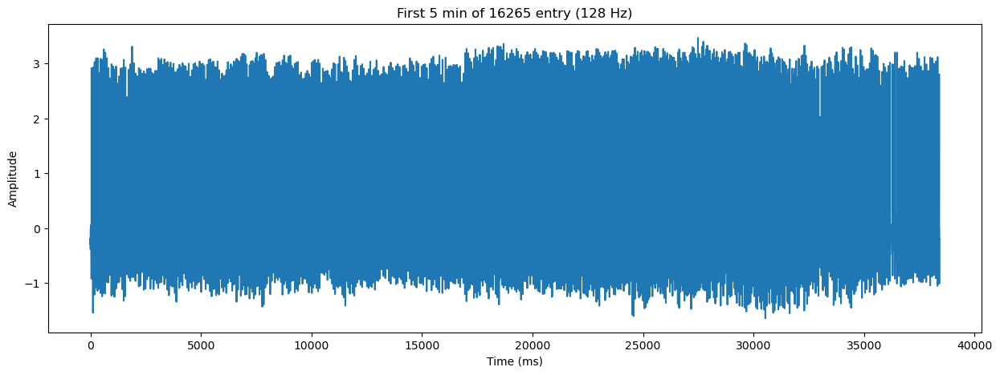

In [12]:
plt.figure(figsize=(15, 5))
plt.subplot()
plt.plot(first5minOF16265)
plt.title('First 5 min of 16265 entry (128 Hz)')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

plt.figure(figsize=(15, 5))
plt.subplot()
plt.plot(second5minOF16265)
plt.title('First 5 min of 16265 entry (128 Hz)')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

# Denoise

In [13]:
def denoise_signal(X, dwt_transform, dlevels, cutoff_low, cutoff_high):
    coeffs = pywt.wavedec(X, dwt_transform, level=dlevels)   # wavelet transform 'bior4.4'
    # scale 0 to cutoff_low 
    for ca in range(0,cutoff_low):
        coeffs[ca]=np.multiply(coeffs[ca],[0.0])
    # scale cutoff_high to end
    for ca in range(cutoff_high, len(coeffs)):
        coeffs[ca]=np.multiply(coeffs[ca],[0.0])
    Y = pywt.waverec(coeffs, dwt_transform) # inverse wavelet transform
    return Y  

### RB fam

In [14]:
rb = ['rbio1.1', 'rbio1.3', 'rbio1.5', 'rbio2.2', 'rbio2.4', 'rbio2.6', 'rbio2.8', 'rbio3.1', 'rbio3.3', 'rbio3.5', 'rbio3.7', 'rbio3.9', 'rbio4.4', 'rbio5.5', 'rbio6.8']

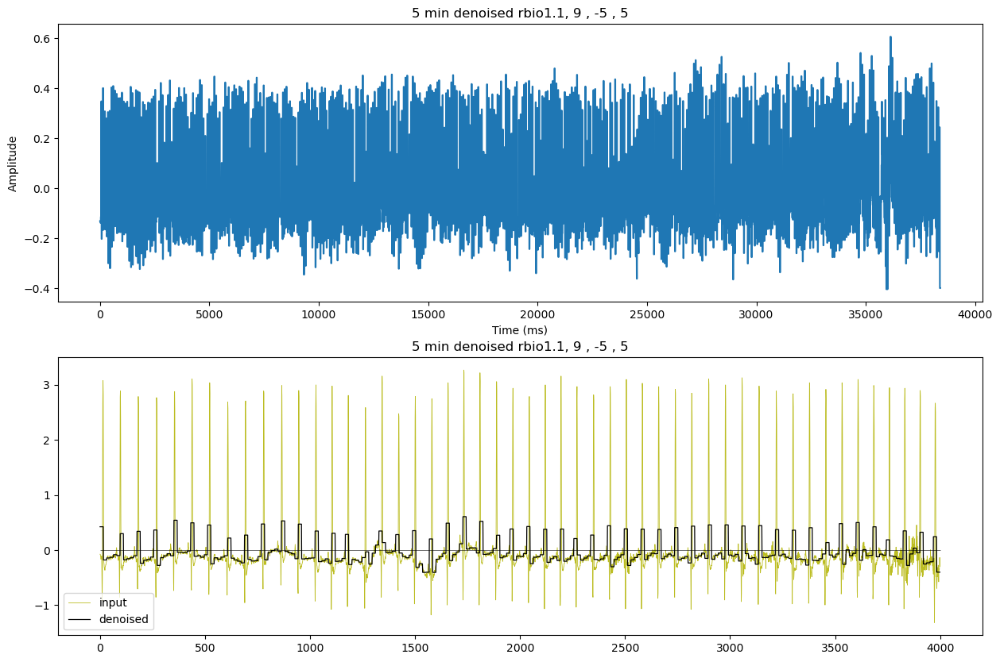

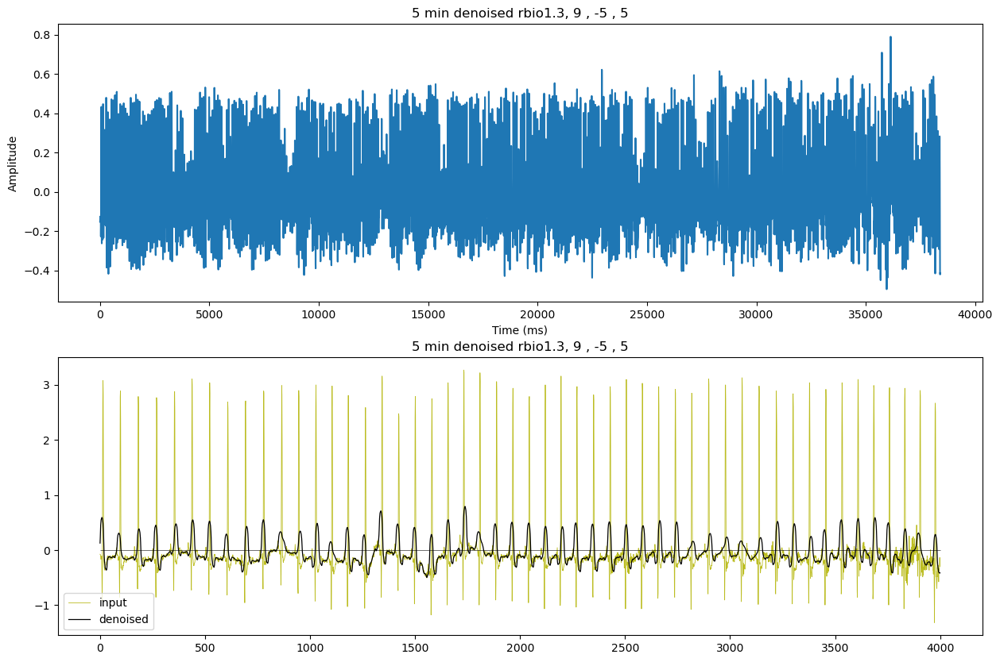

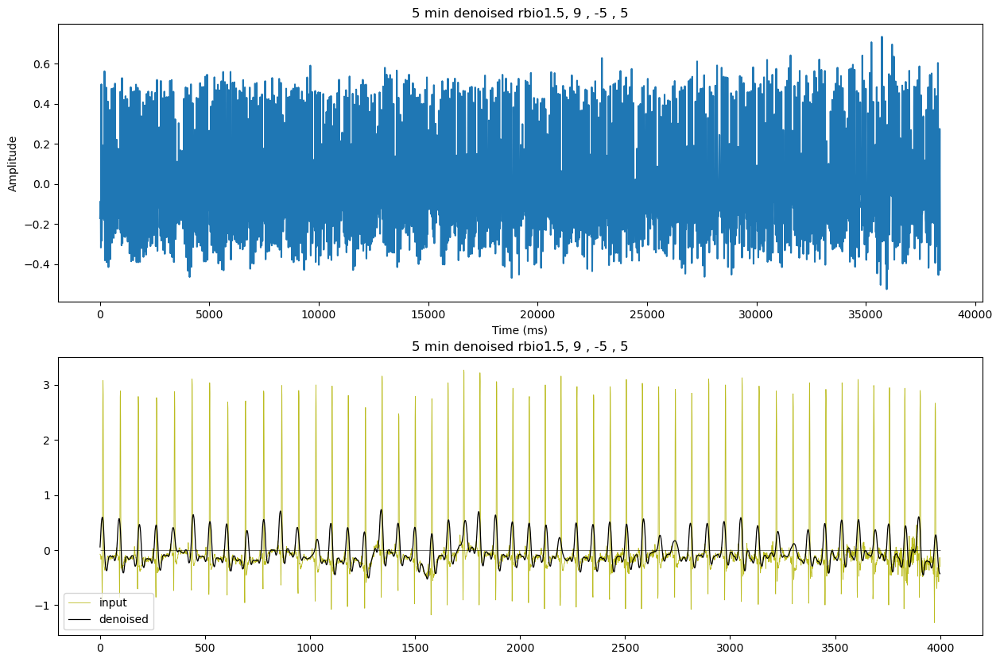

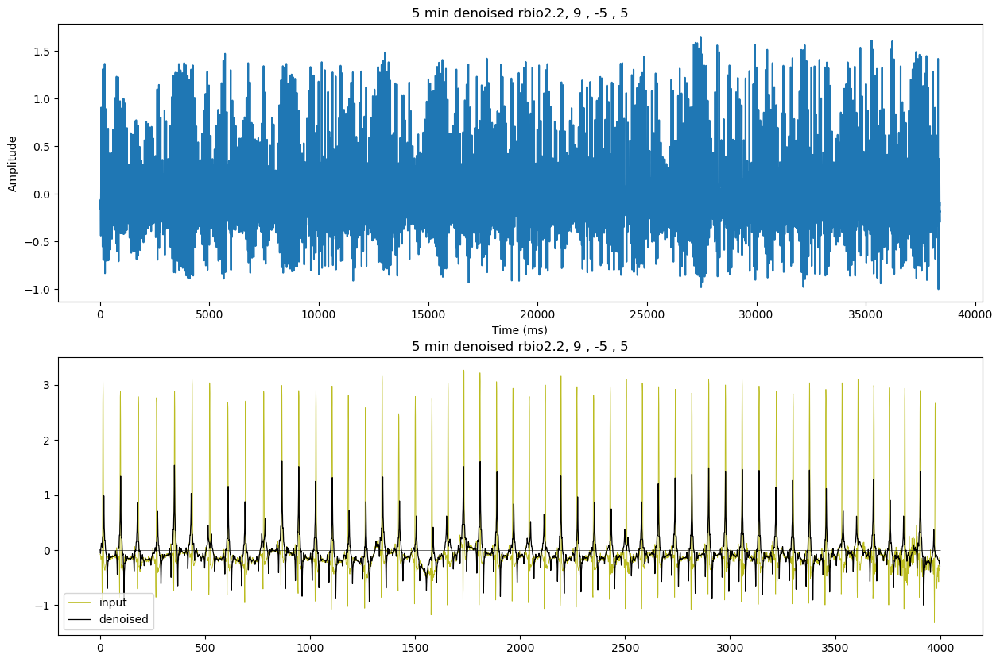

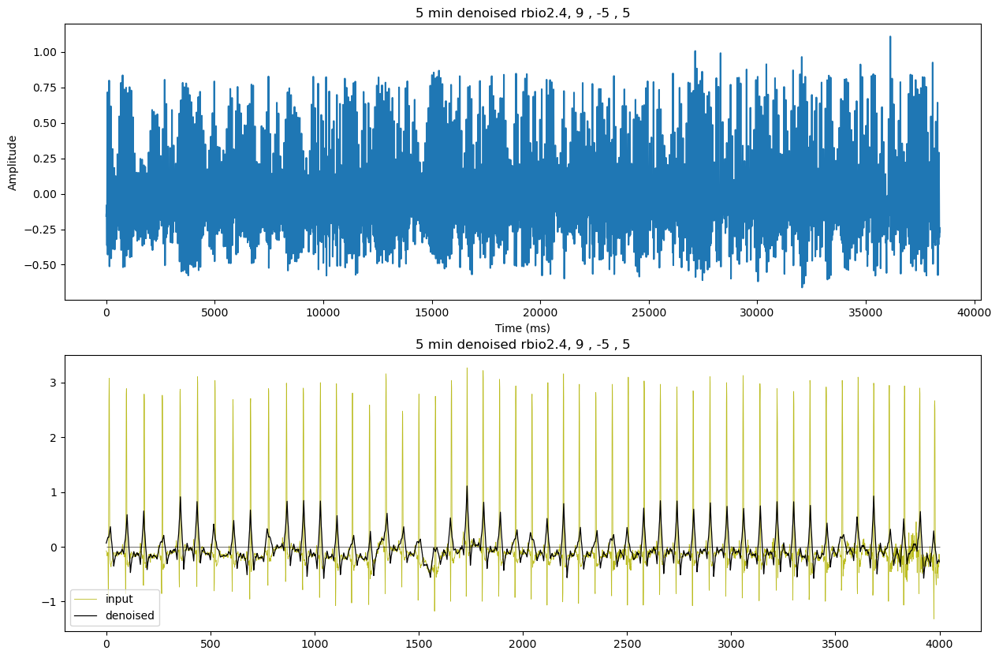

...

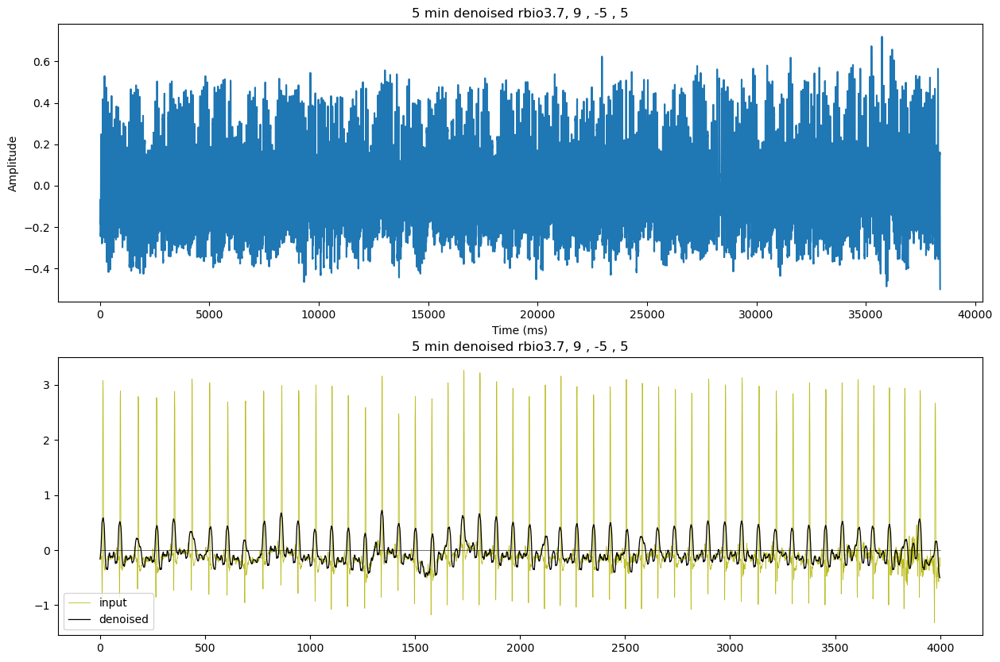

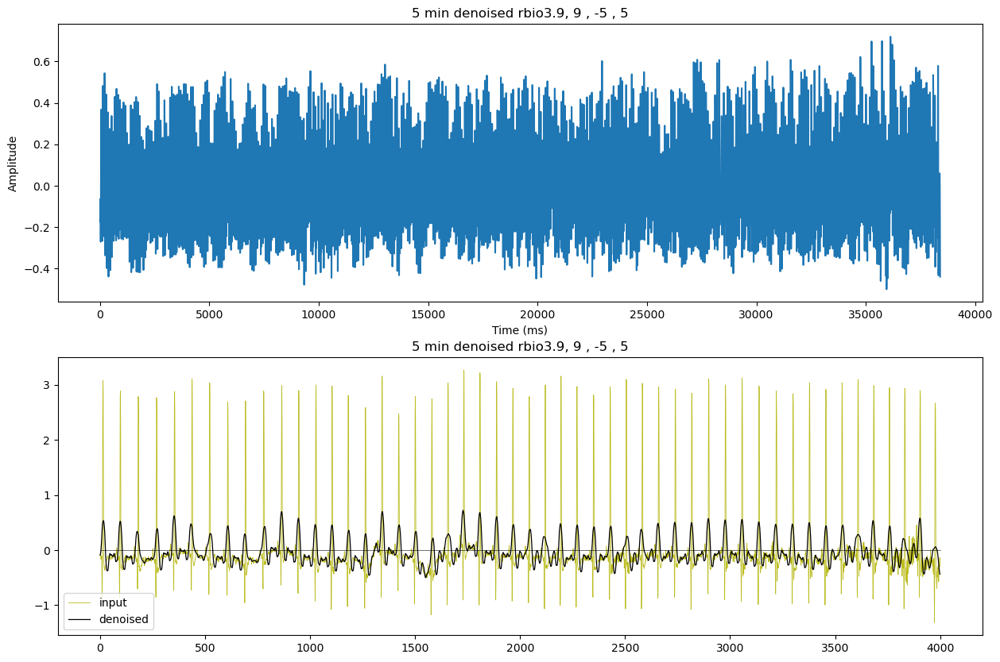

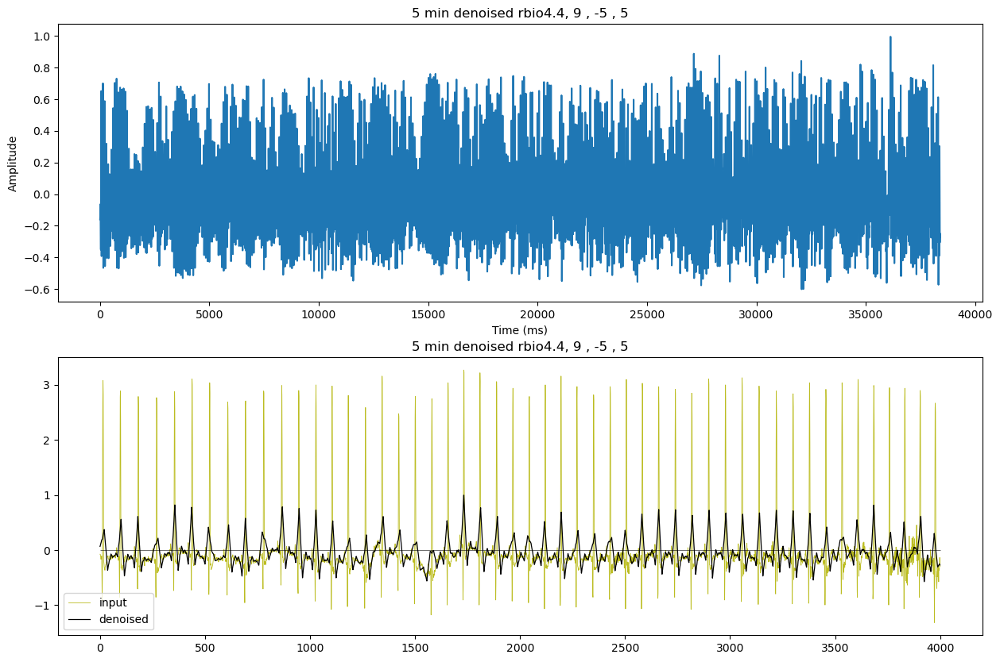

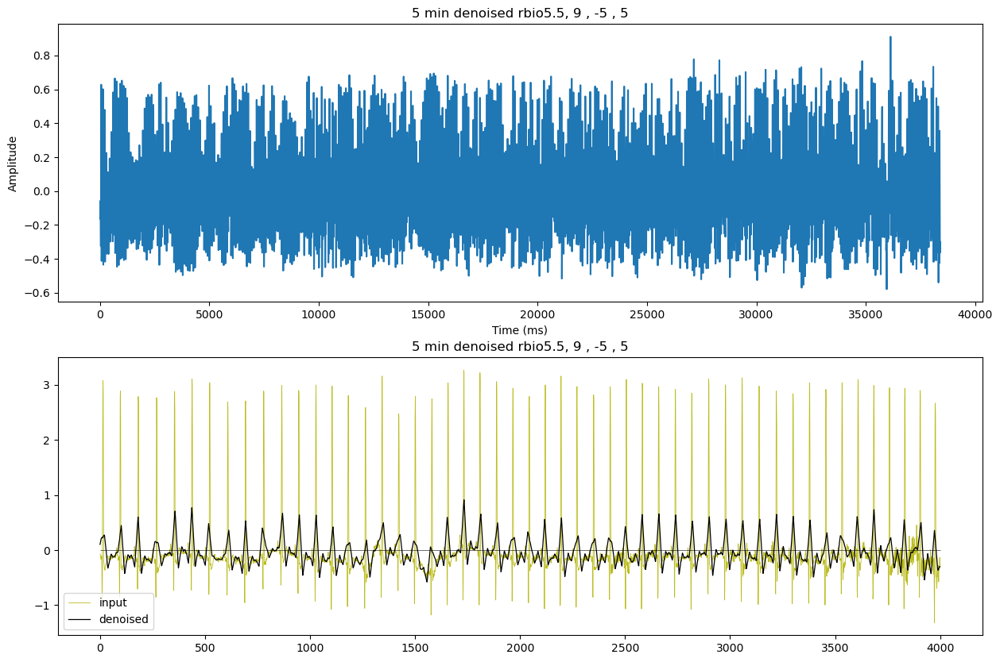

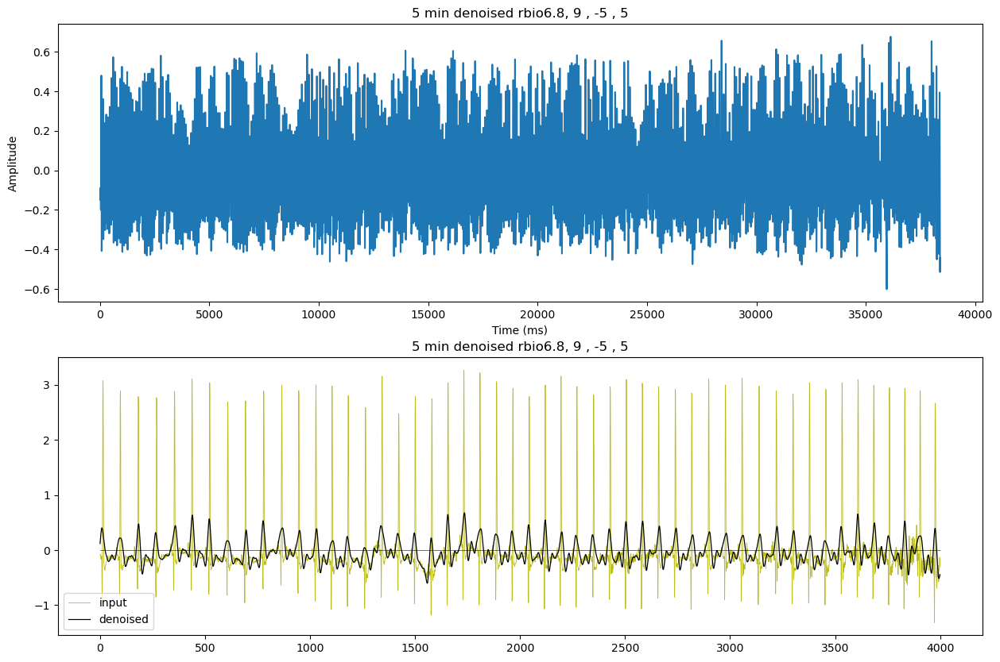

In [26]:
for i in range(len(rb)):
    denoised_ex = denoise_signal(first5minOF16265, rb[i], 8 , -1 , 5)
    
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 1, 1)
    plt.plot(denoised_ex)
    plt.title(f'5 min denoised {rb[i]}, 9 , -5 , 5')
    plt.xlabel('Time (ms)')
    plt.ylabel('Amplitude')

    plt.subplot(2, 1, 2)
    plt.plot(first5minOF16265[-4000:], color='tab:olive', linewidth=0.6,label = 'input')
    plt.title(f'5 min denoised {rb[i]}, 9 , -5 , 5')
    plt.plot(denoised_ex[-4000:], color='black', linewidth=0.9,label = 'denoised')
    plt.hlines(0,0,4000,color='black', linewidth=0.4)
    plt.legend()
    plt.show()

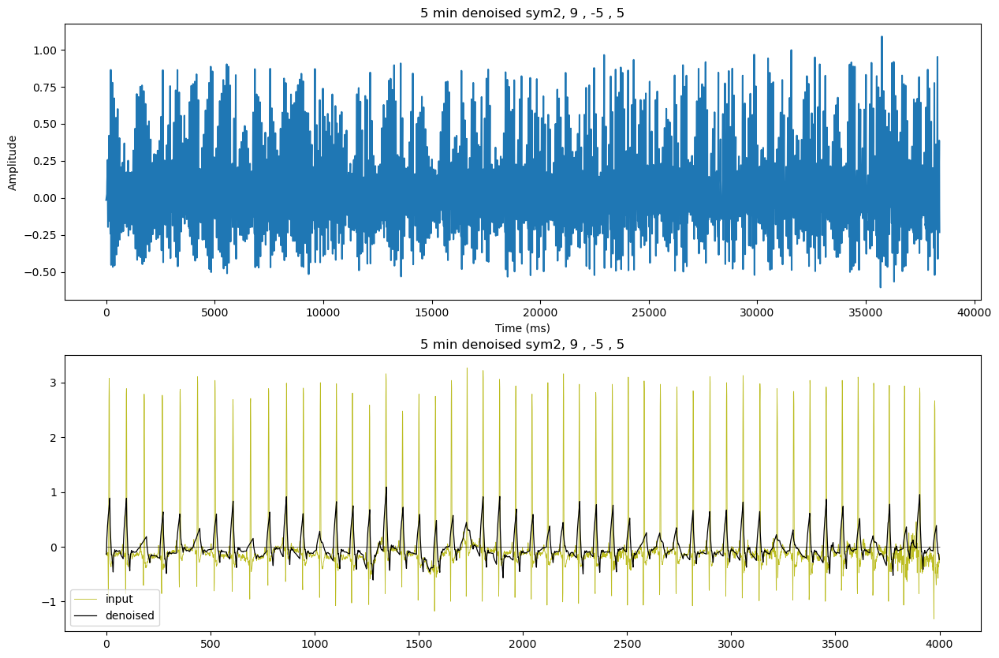

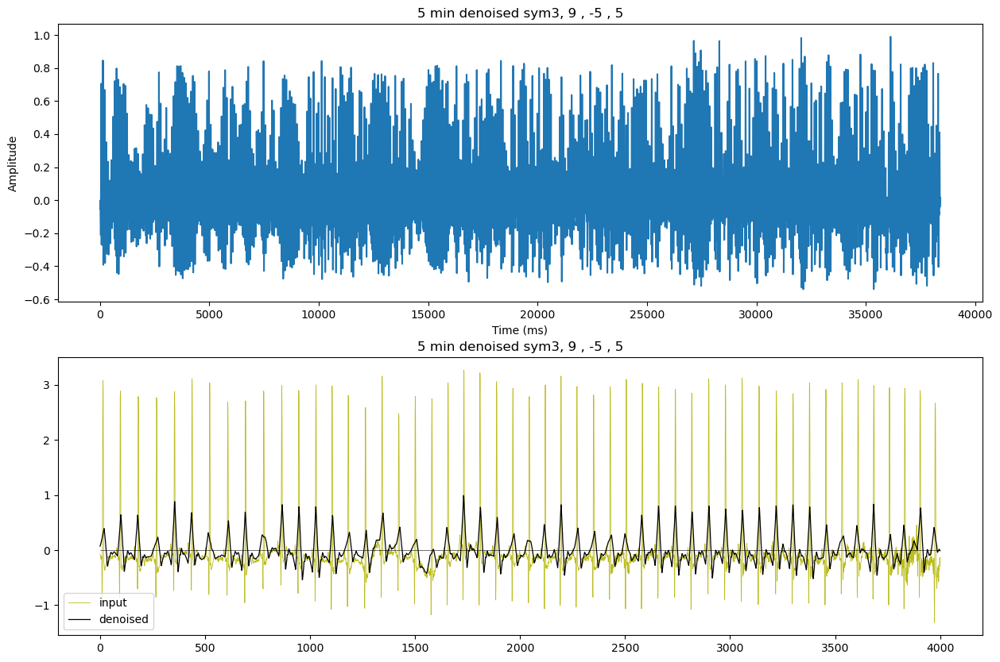

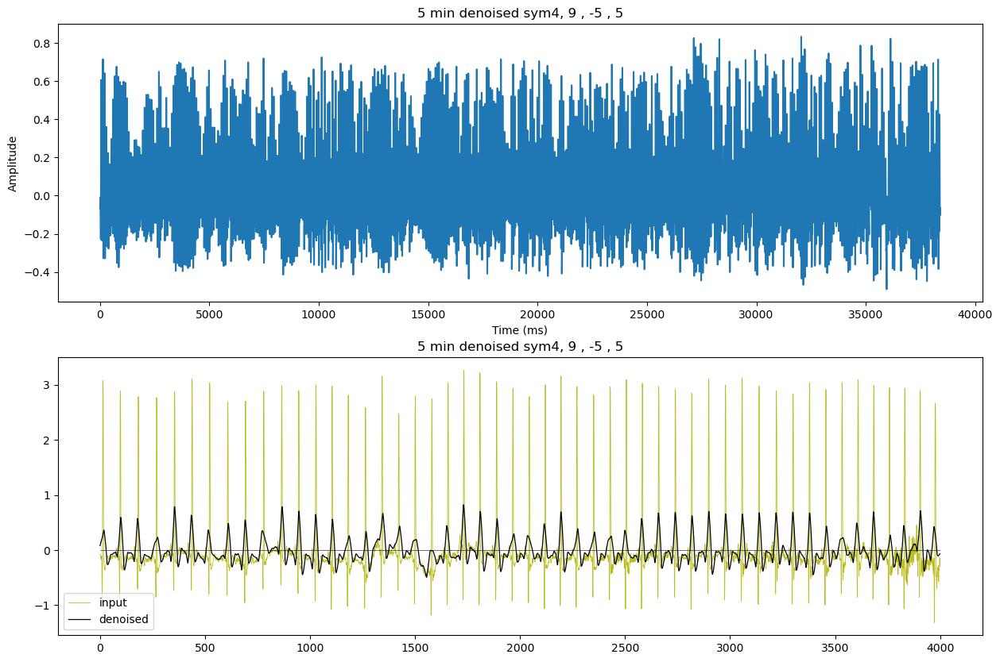

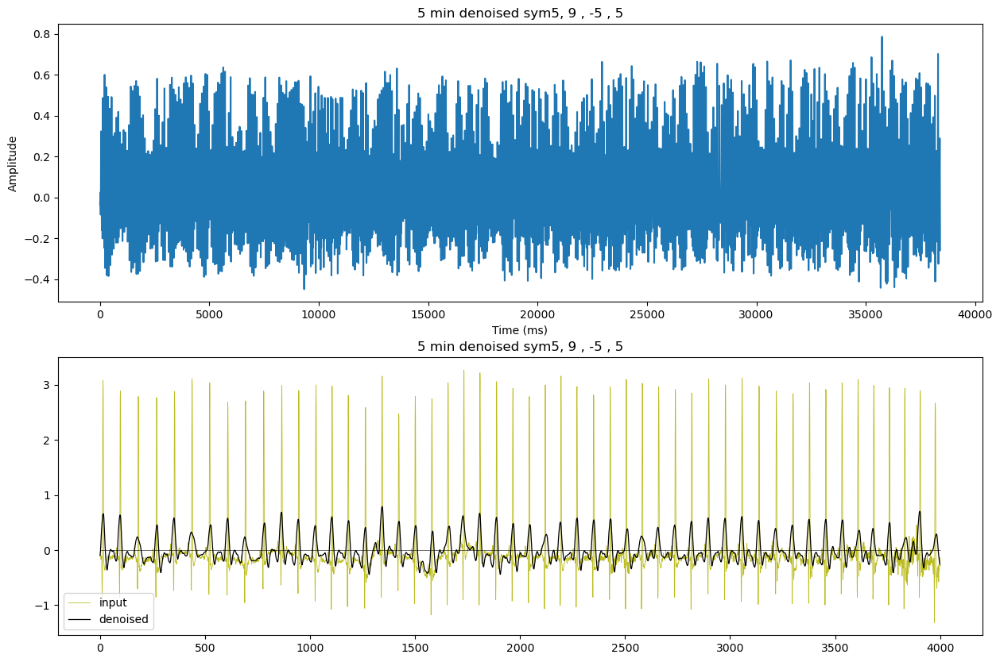

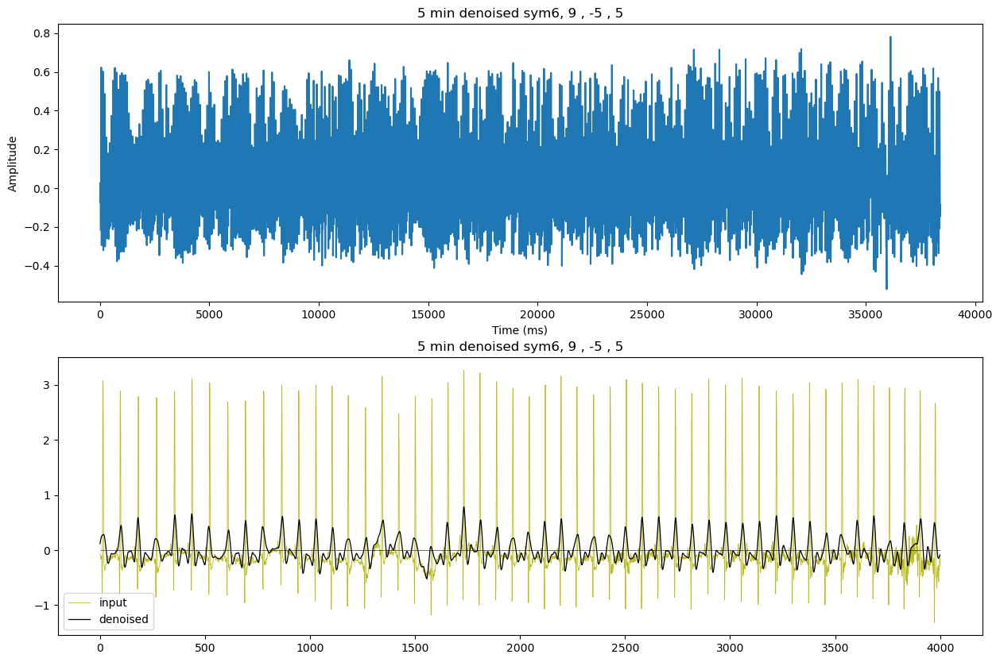

...

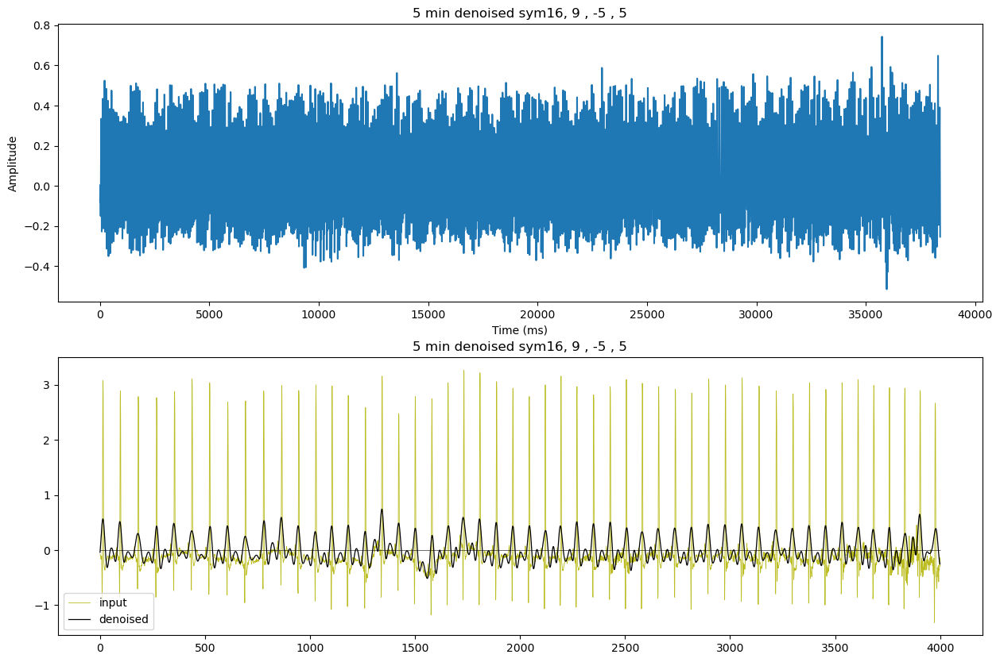

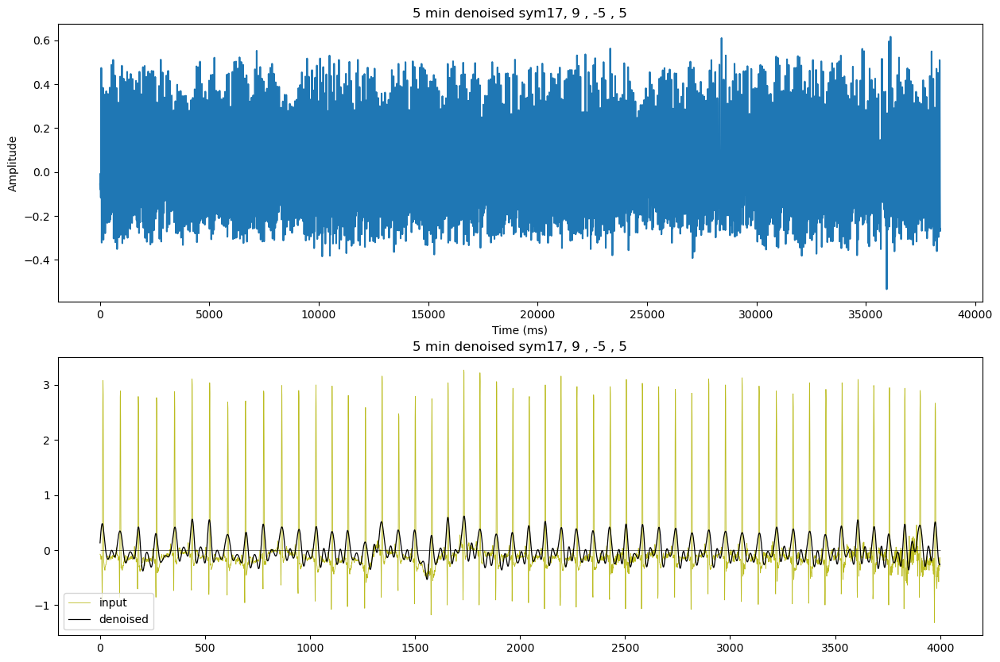

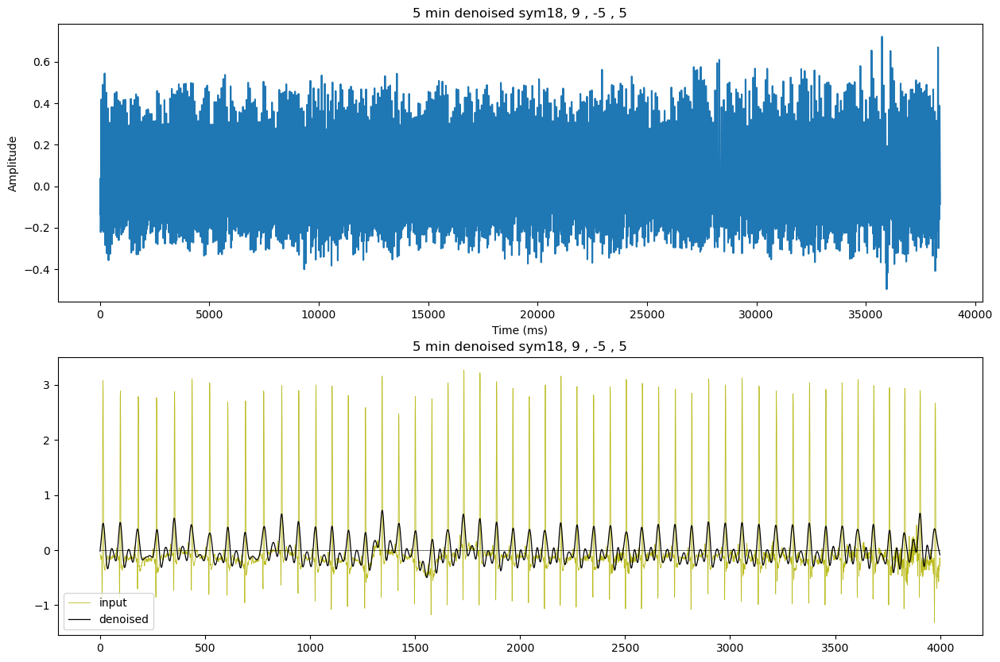

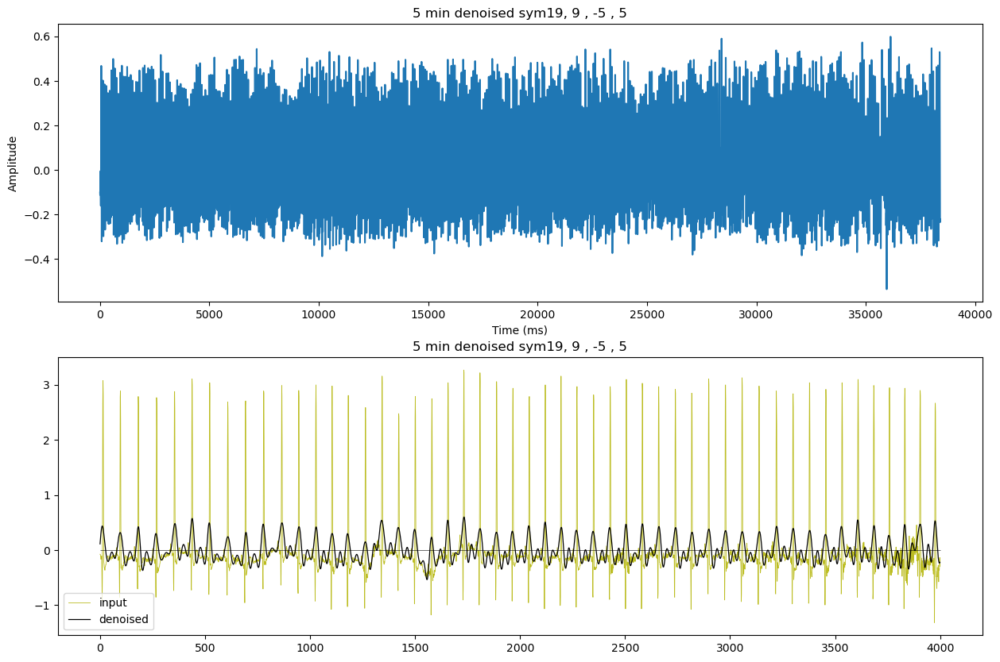

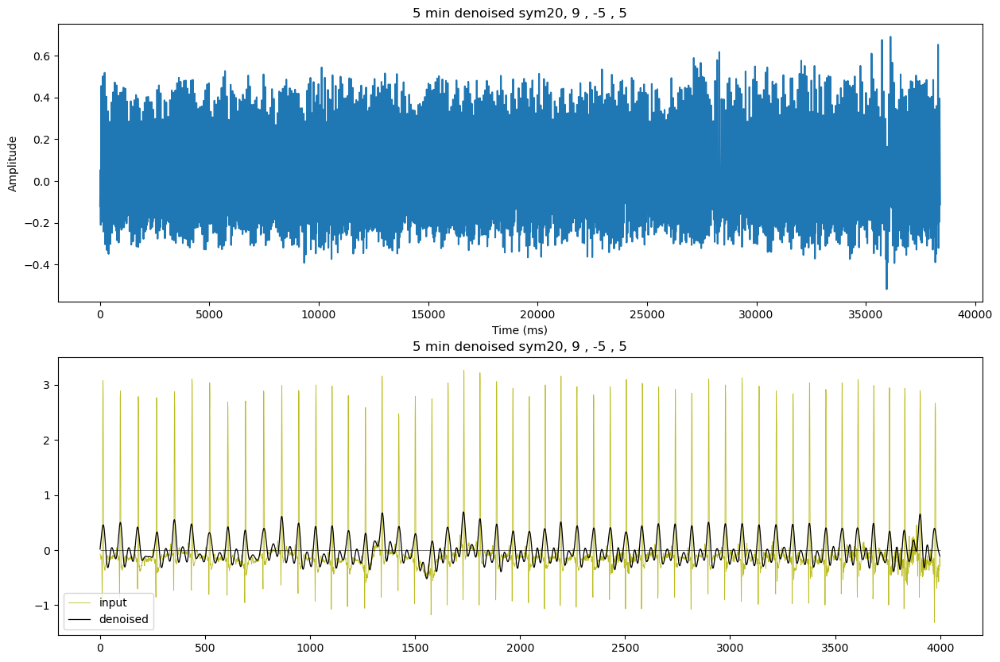

In [29]:
symfam = ['sym2', 'sym3', 'sym4', 'sym5', 'sym6', 
 'sym7', 'sym8', 'sym9', 'sym10', 'sym11', 
 'sym12', 'sym13', 'sym14', 'sym15', 'sym16', 
 'sym17', 'sym18', 'sym19', 'sym20']

for i in range(len(symfam)):
    denoised_ex = denoise_signal(first5minOF16265, symfam[i], 8 , 1 , 5)
    
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 1, 1)
    plt.plot(denoised_ex)
    plt.title(f'5 min denoised {symfam[i]}, 9 , -5 , 5')
    plt.xlabel('Time (ms)')
    plt.ylabel('Amplitude')

    plt.subplot(2, 1, 2)
    plt.plot(first5minOF16265[-4000:], color='tab:olive', linewidth=0.6,label = 'input')
    plt.title(f'5 min denoised {symfam[i]}, 9 , -5 , 5')
    plt.plot(denoised_ex[-4000:], color='black', linewidth=0.9,label = 'denoised')
    plt.hlines(0,0,4000,color='black', linewidth=0.4)
    plt.legend()
    plt.show()

# R peak

In [30]:
denoised_sym_19 = denoise_signal(first5minOF16265, 'sym19', 8 , 1 , 5)
denoised_sym_11 = denoise_signal(first5minOF16265, 'sym11', 8 , 1 , 5)
denoised_rbio_6_8 = denoise_signal(first5minOF16265, 'rbio6.8', 8 , -1 , 5)

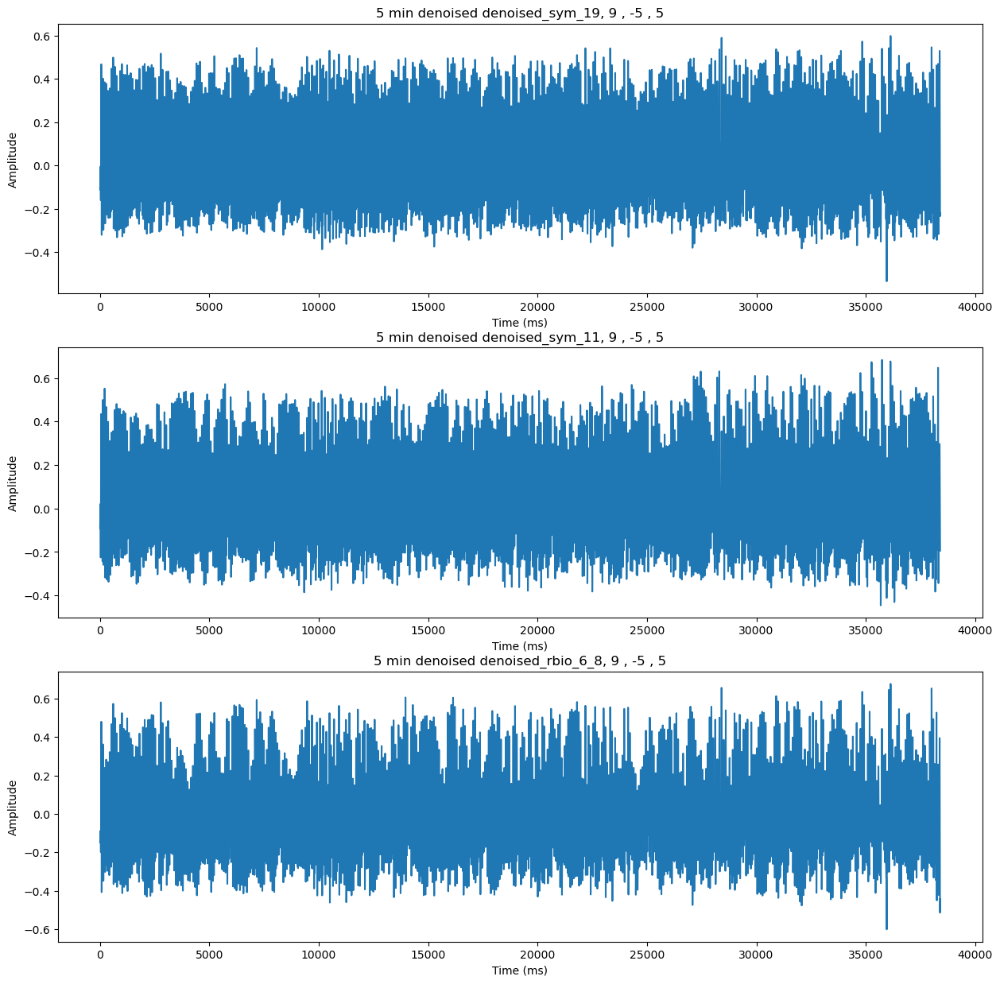

In [33]:
plt.figure(figsize=(15, 15))

plt.subplot(3, 1, 1)
plt.plot(denoised_sym_19)
plt.title(f'5 min denoised denoised_sym_19, 9 , -5 , 5')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')


plt.subplot(3, 1, 2)
plt.plot(denoised_sym_11)
plt.title(f'5 min denoised denoised_sym_11, 9 , -5 , 5')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(3, 1, 3)
plt.plot(denoised_rbio_6_8)
plt.title(f'5 min denoised denoised_rbio_6_8, 9 , -5 , 5')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

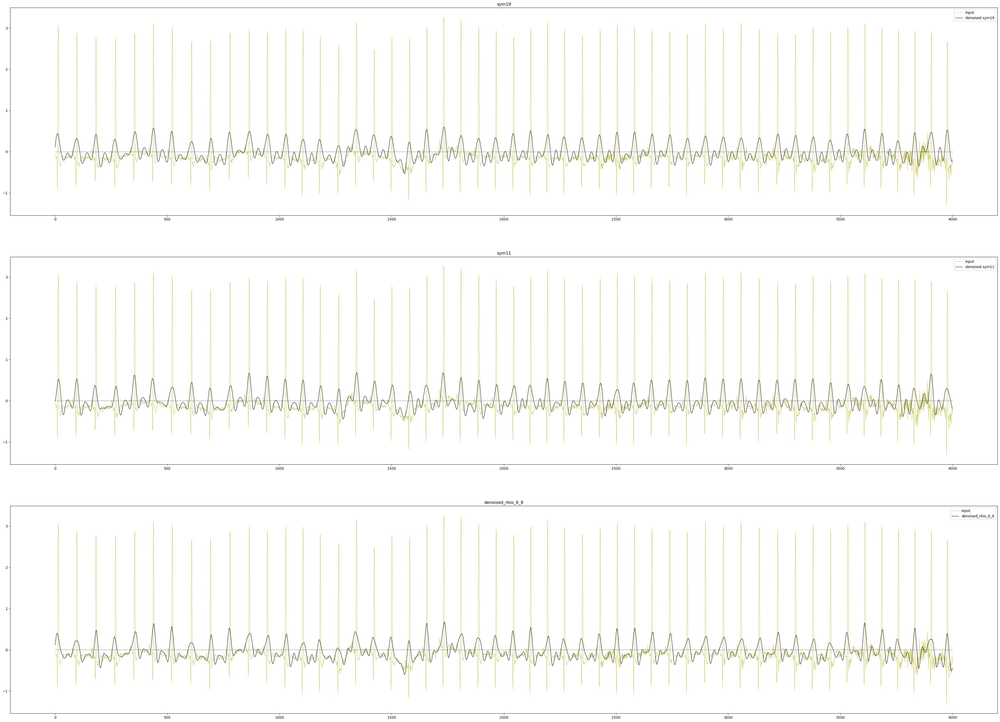

In [35]:
plt.figure(figsize=(50,36))
plt.subplot(3, 1, 1)
plt.plot(first5minOF16265[-4000:], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(denoised_sym_19[-4000:], color='black', linewidth=0.9,label = 'denoised sym19')
plt.title('sym19')
plt.hlines(0,0,4000,color='black', linewidth=0.4)
plt.legend()

plt.subplot(3, 1, 2)
plt.plot(first5minOF16265[-4000:], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(denoised_sym_11[-4000:], color='black', linewidth=0.9,label = 'denoised sym11')
plt.title('sym11')
plt.hlines(0,0,4000,color='black', linewidth=0.4)
plt.legend()

plt.subplot(3, 1, 3)
plt.plot(first5minOF16265[-4000:], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(denoised_rbio_6_8[-4000:], color='black', linewidth=0.9,label = 'denoised_rbio_6_8')
plt.title('denoised_rbio_6_8')
plt.hlines(0,0,4000,color='black', linewidth=0.4)
plt.legend()

plt.show()

In [36]:
BASIC_SRATE = 128
signal_pad_samples = 10
signal_pad = np.zeros(signal_pad_samples) # pad one sec to detect initial peaks properly
detectors = Detectors(BASIC_SRATE)
detectors = {
            'pan_tompkins_detector':[detectors.pan_tompkins_detector, []],
            'hamilton_detector':[detectors.hamilton_detector, []],
            'christov_detector':[detectors.christov_detector, []],
            'engzee_detector':[detectors.engzee_detector, []],
            'swt_detector':[detectors.swt_detector, []],
            'two_average_detector':[detectors.two_average_detector, []],
            }

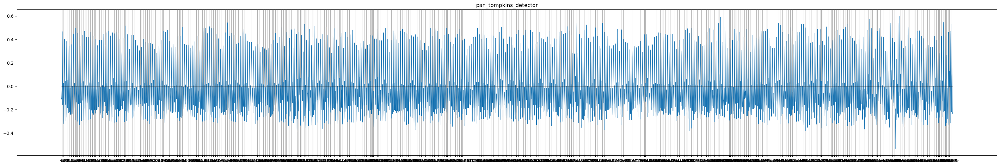

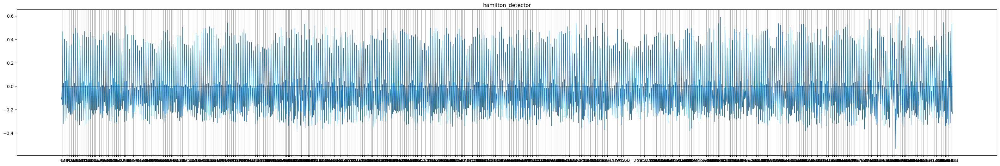

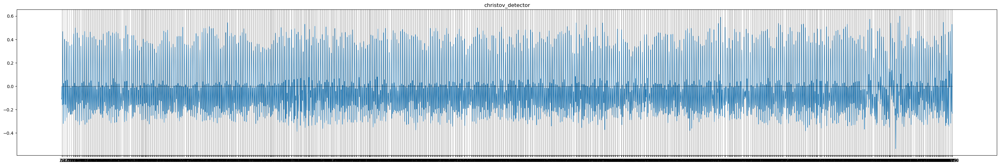

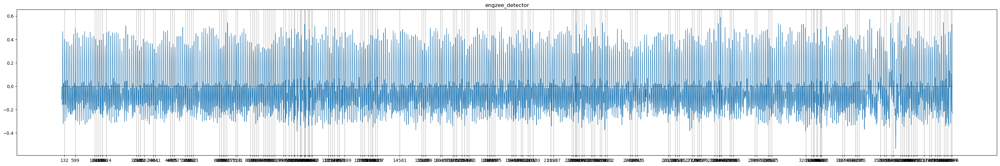

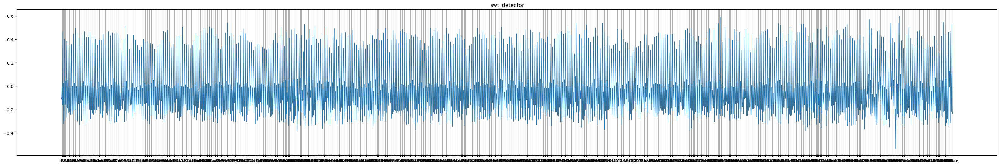

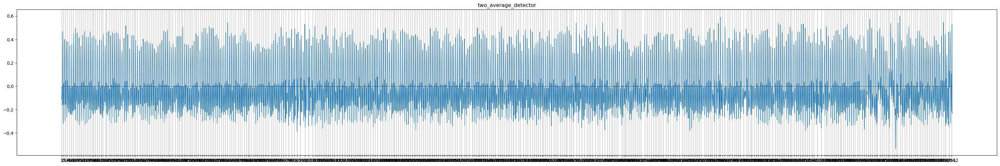

In [37]:
denoised_sym_19_rpeak = denoised_sym_19

for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,denoised_sym_19_rpeak)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(denoised_sym_19_rpeak,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,38400,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

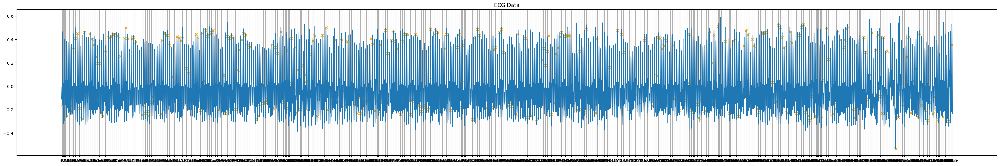

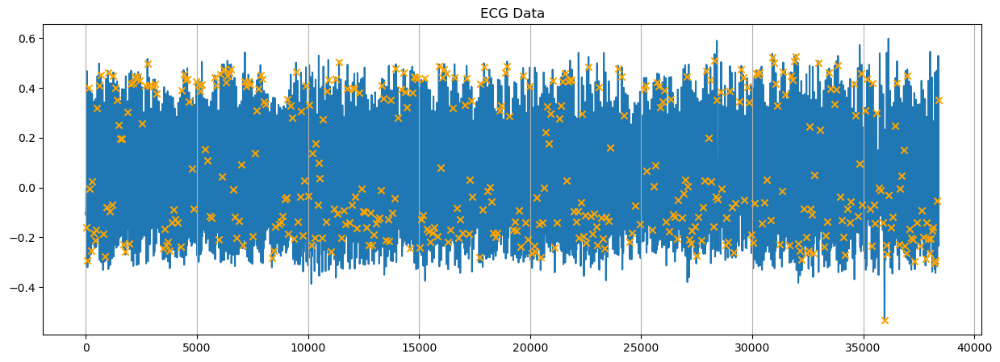

In [44]:
data_signal_sym19 = denoised_sym_19_rpeak
data_peaks_sym19_hamilton = detectors['swt_detector'][1]
segments = denoised_sym_19_rpeak

plt.figure(figsize=(40,6))
plt.title('ECG Data')
plt.plot(segments)
plt.scatter(data_peaks_sym19_hamilton, data_signal_sym19[data_peaks_sym19_hamilton], color='orange', marker='x', label='R-peaks')
plt.hlines(0,0,38400,color='black', linewidth=0.4)
plt.xticks(data_peaks_sym19_hamilton)
plt.grid(axis='x')
plt.show()

plt.figure(figsize=(15,5))
plt.title('ECG Data')
plt.scatter(data_peaks_sym19_hamilton, data_signal_sym19[data_peaks_sym19_hamilton], color='orange', marker='x', label='R-peaks', zorder=2)
plt.plot(segments, zorder=1)
plt.grid(axis='x')
plt.show()

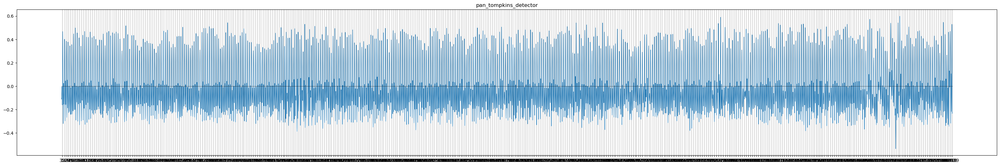

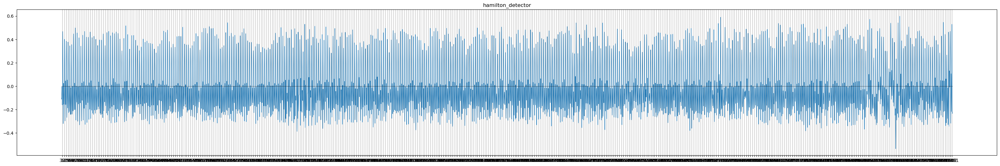

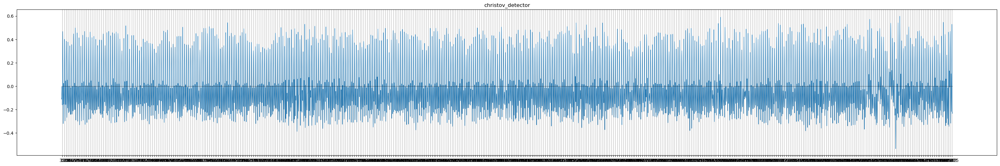

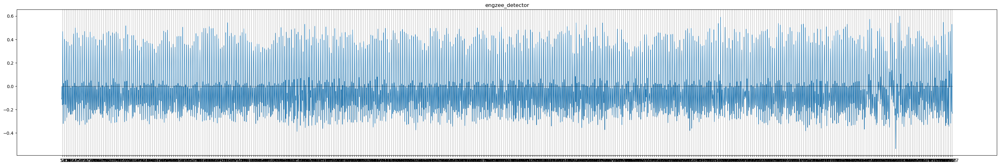

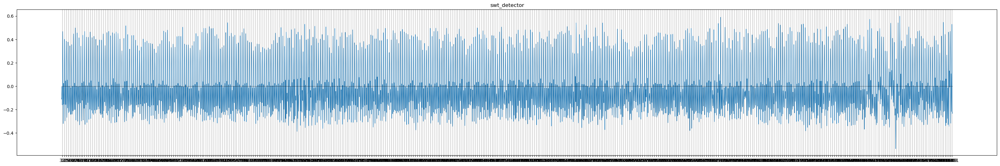

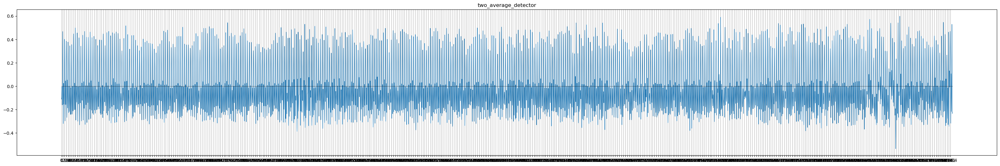

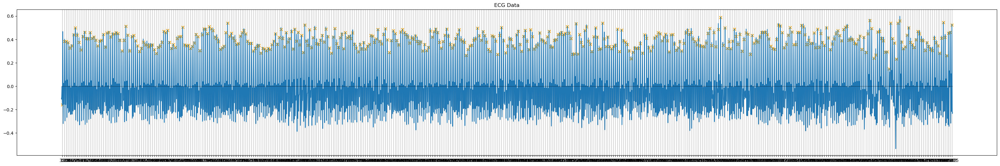

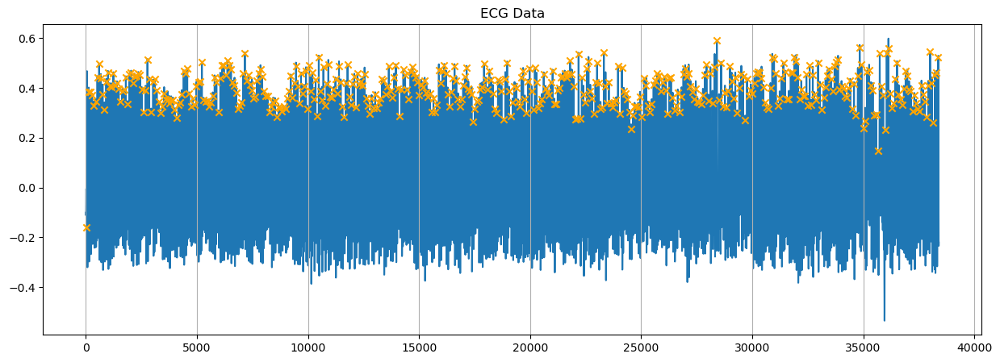

In [45]:
BASIC_SRATE = 128
signal_pad_samples = 10
signal_pad = np.zeros(signal_pad_samples) # pad one sec to detect initial peaks properly
detectors = Detectors(BASIC_SRATE)
detectors = {
            'pan_tompkins_detector':[detectors.pan_tompkins_detector, []],
            'hamilton_detector':[detectors.hamilton_detector, []],
            'christov_detector':[detectors.christov_detector, []],
            'engzee_detector':[detectors.engzee_detector, []],
            'swt_detector':[detectors.swt_detector, []],
            'two_average_detector':[detectors.two_average_detector, []],
            }


denoised_sym_19_rpeak = first5minOF16265

for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,denoised_sym_19_rpeak)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(denoised_sym_19,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,38400,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

data_signal_sym19 = denoised_sym_19
data_peaks_sym19_hamilton = detectors['christov_detector'][1]

plt.figure(figsize=(40,6))
plt.title('ECG Data')
plt.plot(data_signal_sym19)
plt.scatter(data_peaks_sym19_hamilton, data_signal_sym19[data_peaks_sym19_hamilton], color='orange', marker='x', label='R-peaks')
plt.hlines(0,0,38400,color='black', linewidth=0.4)
plt.xticks(data_peaks_sym19_hamilton)
plt.grid(axis='x')
plt.show()

plt.figure(figsize=(15,5))
plt.title('ECG Data')
plt.scatter(data_peaks_sym19_hamilton, data_signal_sym19[data_peaks_sym19_hamilton], color='orange', marker='x', label='R-peaks', zorder=2)
plt.plot(denoised_sym_19, zorder=1)
plt.grid(axis='x')
plt.show()

In [46]:
sig_denoised_ex_1 = denoise_signal(first5minOF16265,'bior4.4', 9 , 1 , 7)

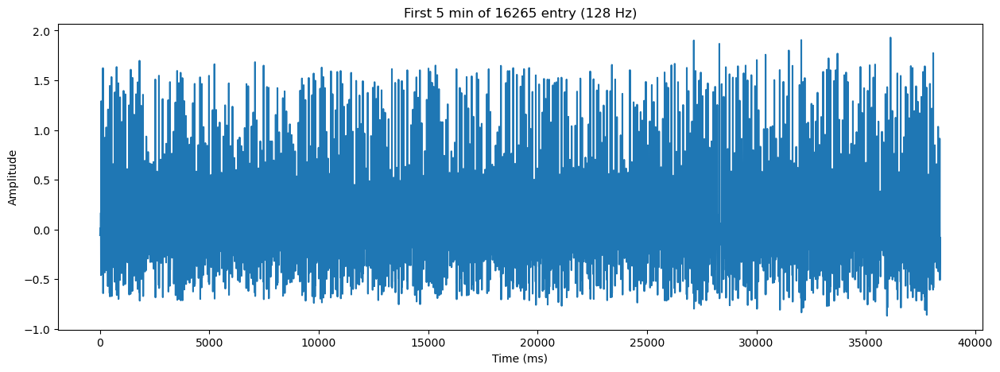

In [50]:
plt.figure(figsize=(15, 5))
plt.subplot()
plt.plot(sig_denoised_ex_1)
plt.title('First 5 min of 16265 entry (128 Hz)')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

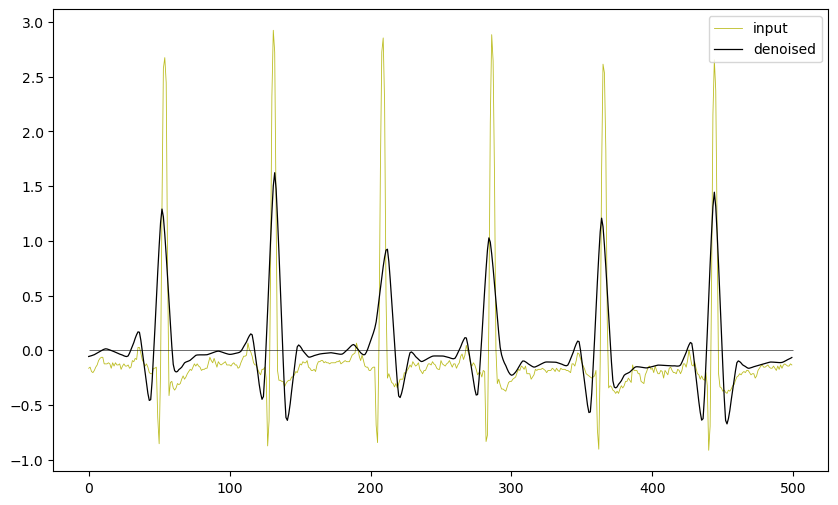

In [51]:
plt.figure(figsize=(10,6))

plt.plot(first5minOF16265[0:500], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(sig_denoised_ex_1[0:500], color='black', linewidth=0.9,label = 'denoised')
plt.hlines(0,0,500,color='black', linewidth=0.4)
plt.legend()
plt.show()

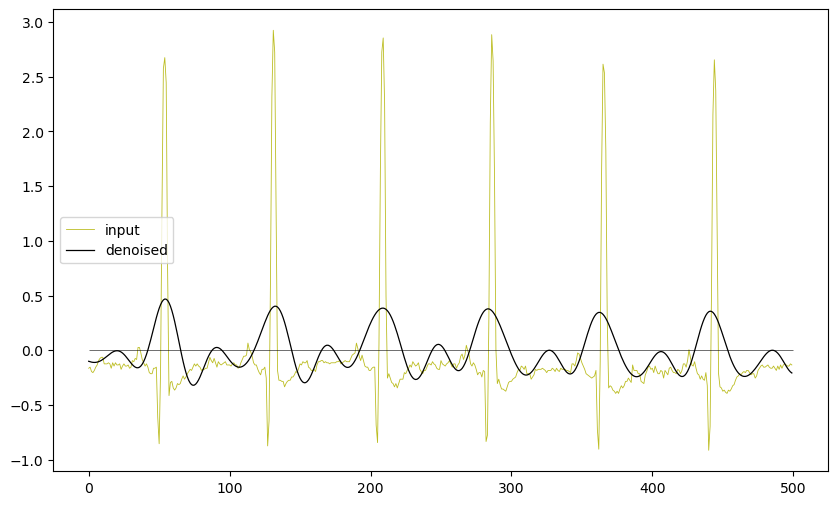

In [52]:
plt.figure(figsize=(10,6))

plt.plot(first5minOF16265[0:500], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(denoised_sym_19[0:500], color='black', linewidth=0.9,label = 'denoised')
plt.hlines(0,0,500,color='black', linewidth=0.4)
plt.legend()
plt.show()

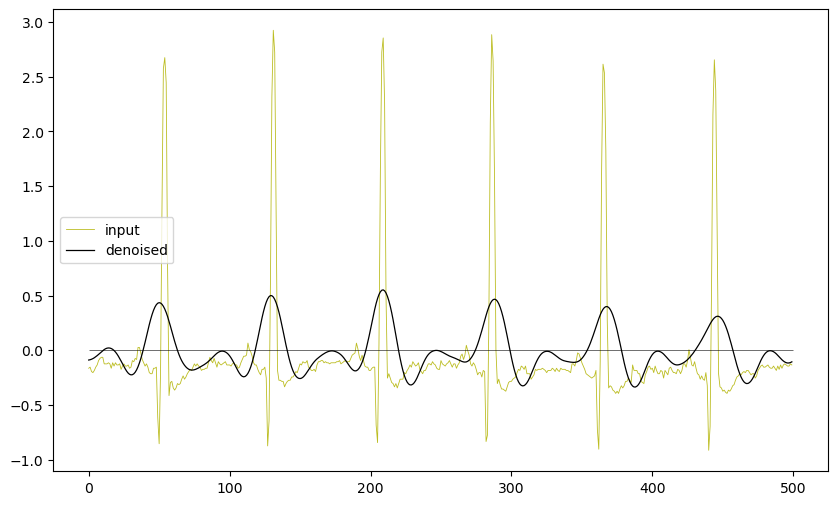

In [53]:
plt.figure(figsize=(10,6))

plt.plot(first5minOF16265[0:500], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(denoised_sym_11[0:500], color='black', linewidth=0.9,label = 'denoised')
plt.hlines(0,0,500,color='black', linewidth=0.4)
plt.legend()
plt.show()

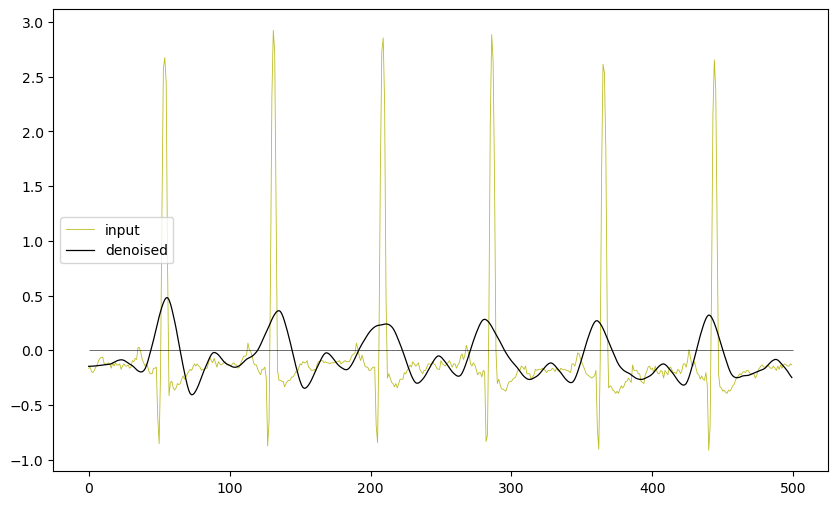

In [54]:
plt.figure(figsize=(10,6))

plt.plot(first5minOF16265[0:500], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(denoised_rbio_6_8[0:500], color='black', linewidth=0.9,label = 'denoised')
plt.hlines(0,0,500,color='black', linewidth=0.4)
plt.legend()
plt.show()

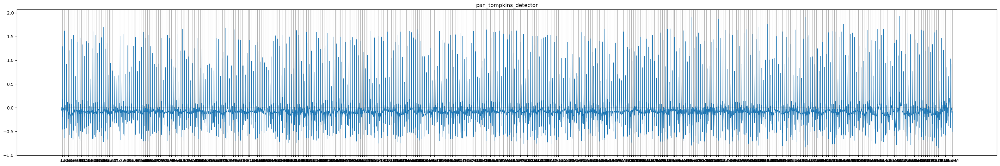

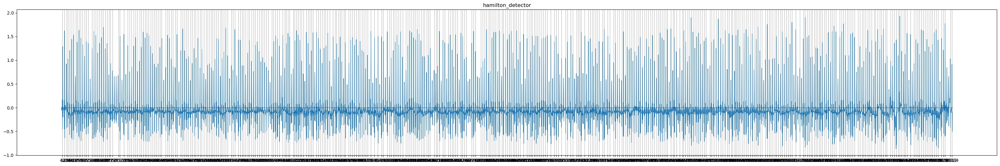

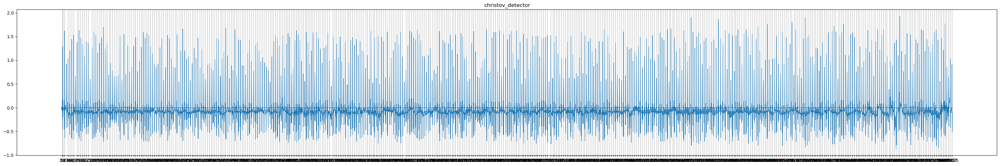

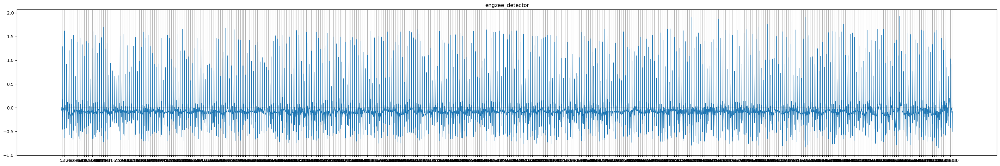

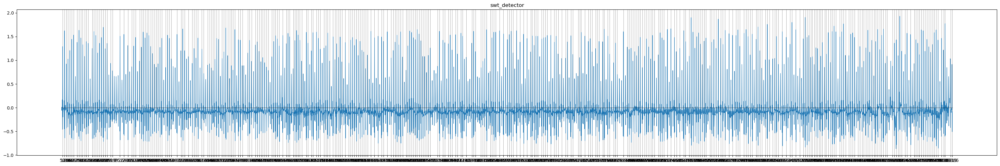

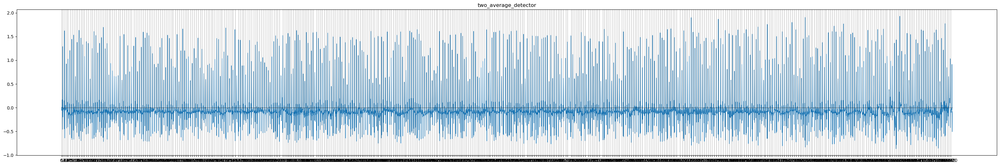

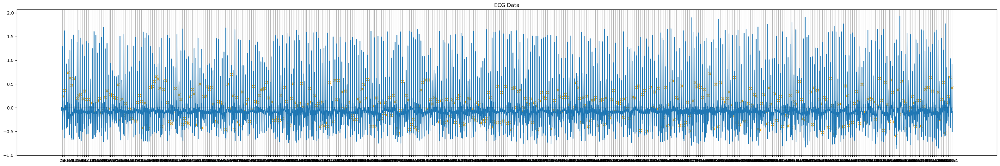

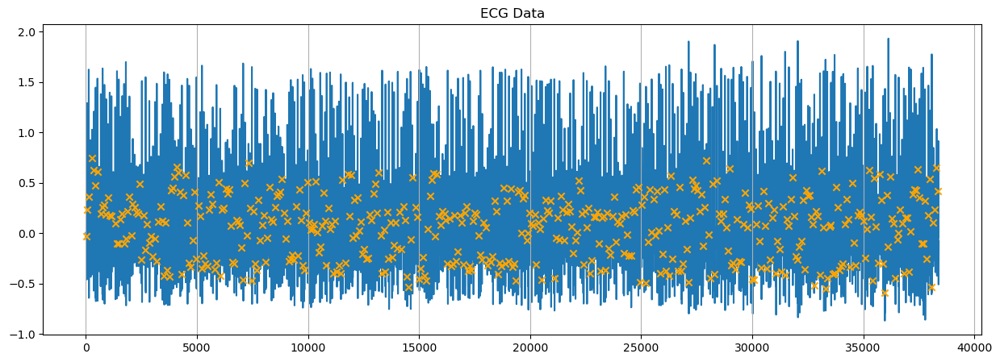

In [58]:
BASIC_SRATE = 128
signal_pad_samples = 10
signal_pad = np.zeros(signal_pad_samples) # pad one sec to detect initial peaks properly
detectors = Detectors(BASIC_SRATE)
detectors_1 = {
            'pan_tompkins_detector':[detectors.pan_tompkins_detector, []],
            'hamilton_detector':[detectors.hamilton_detector, []],
            'christov_detector':[detectors.christov_detector, []],
            'engzee_detector':[detectors.engzee_detector, []],
            'swt_detector':[detectors.swt_detector, []],
            'two_average_detector':[detectors.two_average_detector, []],
            }


denoised_sym_19_rpeak = sig_denoised_ex_1

for kd in detectors_1.keys():
    vd = detectors_1[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,denoised_sym_19_rpeak)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(sig_denoised_ex_1,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,38400,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

data_signal_sym19 = sig_denoised_ex_1
data_peaks_sym19_hamilton = detectors_1['christov_detector'][1]

plt.figure(figsize=(40,6))
plt.title('ECG Data')
plt.plot(data_signal_sym19)
plt.scatter(data_peaks_sym19_hamilton, data_signal_sym19[data_peaks_sym19_hamilton], color='orange', marker='x', label='R-peaks')
plt.hlines(0,0,38400,color='black', linewidth=0.4)
plt.xticks(data_peaks_sym19_hamilton)
plt.grid(axis='x')
plt.show()

plt.figure(figsize=(15,5))
plt.title('ECG Data')
plt.scatter(data_peaks_sym19_hamilton, data_signal_sym19[data_peaks_sym19_hamilton], color='orange', marker='x', label='R-peaks', zorder=2)
plt.plot(sig_denoised_ex_1, zorder=1)
plt.grid(axis='x')
plt.show()

In [59]:
detectors_1['christov_detector'][1]

array([   29,    58,   127,   282,   361,   440,   520,   671,   751,
         831,   911,   992,  1071,  1151,  1318,  1398,  1478,  1559,
        1639,  1718,  1798,  1879,  1959,  2049,  2112,  2192,  2272,
        2352,  2439,  2512,  2600,  2679,  2767,  2853,  2934,  3017,
        3109,  3184,  3271,  3358,  3438,  3513,  3598,  3673,  3754,
        3839,  3919,  4000,  4081,  4160,  4239,  4313,  4402,  4488,
        4566,  4640,  4721,  4806,  4894,  4968,  5058,  5142,  5217,
        5296,  5377,  5457,  5545,  5630,  5710,  5786,  5873,  5967,
        6042,  6128,  6209,  6295,  6374,  6454,  6527,  6601,  6680,
        6766,  6856,  6919,  6998,  7073,  7159,  7249,  7321,  7392,
        7466,  7544,  7616,  7698,  7782,  7854,  7935,  8022,  8096,
        8182,  8271,  8350,  8430,  8510,  8591,  8671,  8751,  8832,
        8920,  9001,  9063,  9136,  9216,  9295,  9377,  9456,  9528,
        9614,  9686,  9752,  9824,  9904,  9984, 10054, 10126, 10198,
       10270, 10344,

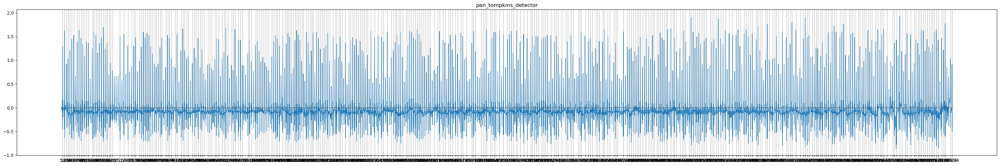

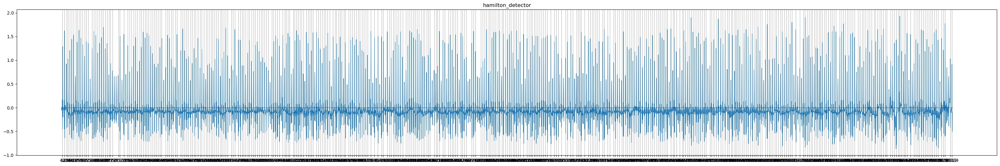

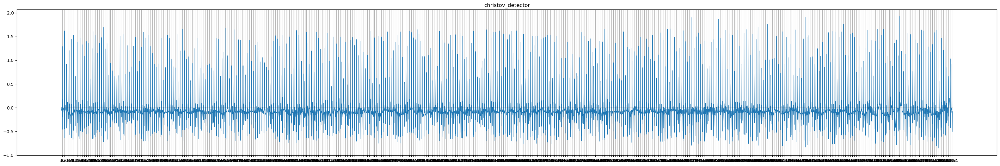

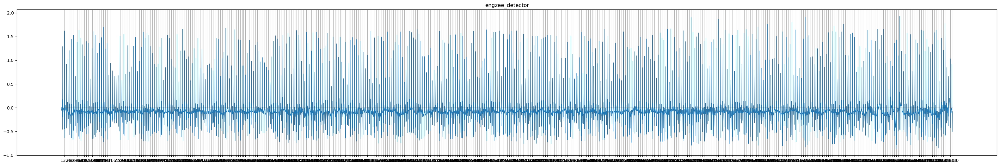

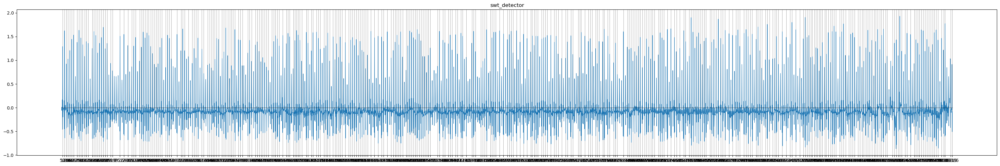

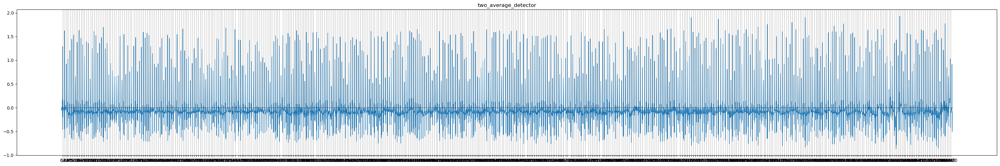

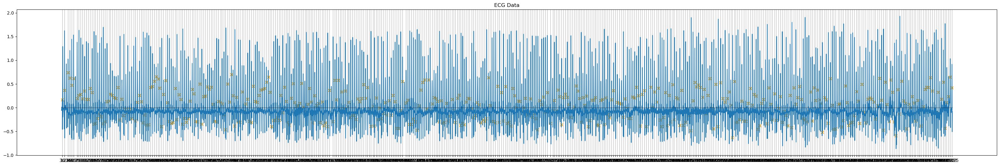

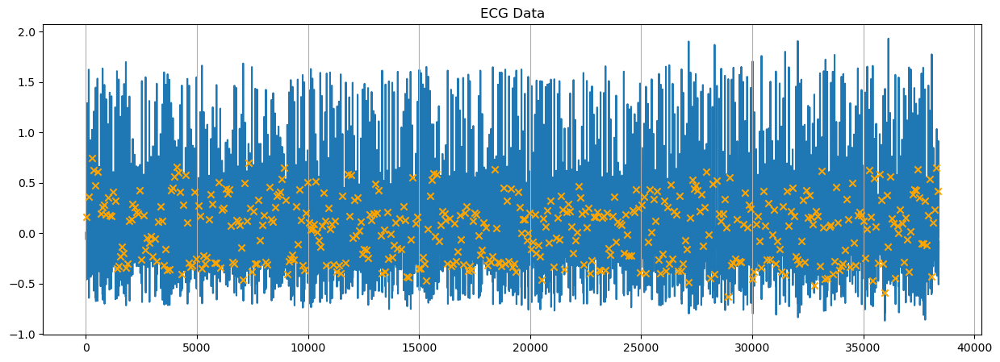

In [60]:
BASIC_SRATE = 128
# signal_pad_samples = 10
# signal_pad = np.zeros(signal_pad_samples) # pad one sec to detect initial peaks properly
detectors = Detectors(BASIC_SRATE)
detectors_1 = {
            'pan_tompkins_detector':[detectors.pan_tompkins_detector, []],
            'hamilton_detector':[detectors.hamilton_detector, []],
            'christov_detector':[detectors.christov_detector, []],
            'engzee_detector':[detectors.engzee_detector, []],
            'swt_detector':[detectors.swt_detector, []],
            'two_average_detector':[detectors.two_average_detector, []],
            }


denoised_sym_19_rpeak = sig_denoised_ex_1

for kd in detectors_1.keys():
    vd = detectors_1[kd]
    r_peaks = np.array(vd[0](denoised_sym_19_rpeak))  # Pass the signal directly without padding
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(sig_denoised_ex_1,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,38400,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

data_signal_sym19 = sig_denoised_ex_1
data_peaks_sym19_hamilton = detectors_1['christov_detector'][1]

plt.figure(figsize=(15,5))
plt.title('ECG Data')
plt.scatter(data_peaks_sym19_hamilton, data_signal_sym19[data_peaks_sym19_hamilton], color='orange', marker='x', label='R-peaks', zorder=2)
plt.plot(sig_denoised_ex_1, zorder=1)
plt.grid(axis='x')
plt.show()

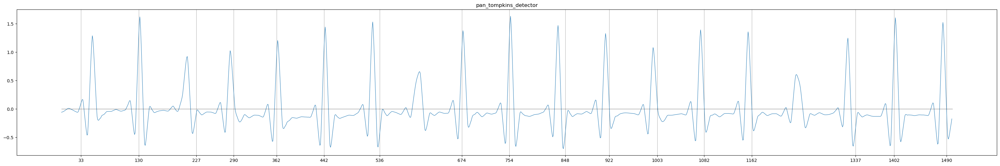

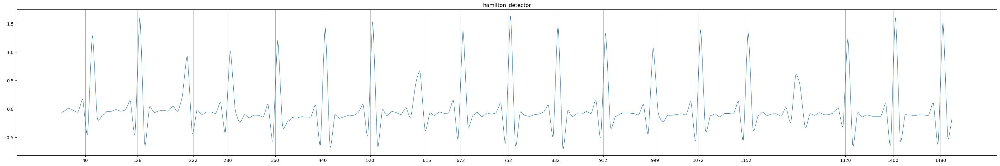

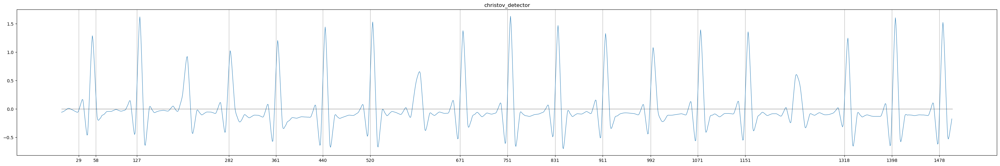

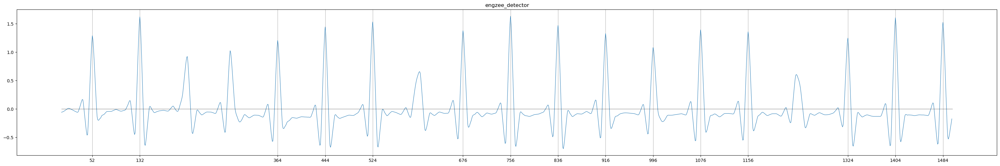

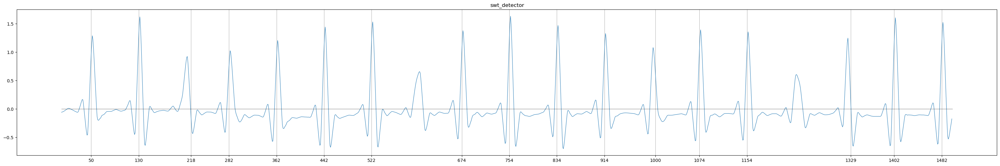

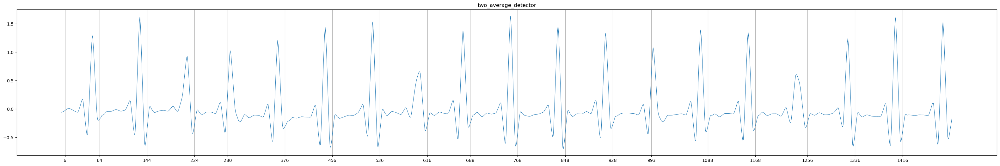

In [62]:
detectors = Detectors(BASIC_SRATE)
detectors_2 = {
            'pan_tompkins_detector':[detectors.pan_tompkins_detector, []],
            'hamilton_detector':[detectors.hamilton_detector, []],
            'christov_detector':[detectors.christov_detector, []],
            'engzee_detector':[detectors.engzee_detector, []],
            'swt_detector':[detectors.swt_detector, []],
            'two_average_detector':[detectors.two_average_detector, []],
            }

signalf_ex_3 = sig_denoised_ex_1
for kd in detectors_2.keys():
    vd = detectors_2[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,sig_denoised_ex_1[:1500])))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(signalf_ex_3[:1500],color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,1500,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()